In [4]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import random
import sys

sys.path.append('../')
from Adapted_Conformal_Prediction.src.ConformalMethods import AdaptiveCP, ACP_data, ACP_plots

# Code for insitialising a head

In [5]:
class Aw(AdaptiveCP):
    def __init__(self, coverage):
        # Book keeping
        self.coverage_target = coverage
        self.interval_size = 50
        self.score_function = lambda xpred, y: (abs(y - xpred))/abs(xpred)
        self.neg_inverse_score =  lambda x_t, Q: (x_t) - (abs(x_t) * Q)
        self.pos_inverse_score = lambda x_t, Q: (x_t) + (abs(x_t) * Q)
    
    def ACI_head(self, timeseries_data: tuple, gamma: float, start_point: int, custom_interval = None):
        # Only change made it adding the yield statement and added start_point functionality.
        
        xpred, y = timeseries_data
        alpha_t_list = [self.coverage_target]

        All_scores = self.score_function(xpred, y)

        err_t_list = []
        conformal_sets_list = []
        
        for i in range(start_point, len(All_scores)):
            Coverage_t = self.C_t(alpha_t_list[-1], All_scores, xpred[i], i, custom_interval)
            conformal_sets_list.append(Coverage_t)

            yield Coverage_t

            error_t = AdaptiveCP.err_t(y[i], Coverage_t)
            err_t_list.append(error_t)

            alpha_t = min(max(alpha_t_list[-1] + (gamma * (self.coverage_target - error_t)), 0), 1)
            alpha_t_list.append(alpha_t)

        return False



# AwACI Method code

In [9]:
class Scalable_Aw(AdaptiveCP):
    def __init__(self, coverage_target):
        # Book keeping.
        self.interval_size = 50
        self.coverage_target = coverage_target

    def set_loss(self, optimal_set, given_set):
         # We want alpha percent above the set radius (Not in the set) hence using pinball loss to discount linearly.
         val = optimal_set - given_set
         if val < 0:
              return (self.coverage_target) * (-1* val)
         else:
              return (1 - self.coverage_target) * val
    
    def vectorise_set_loss(self):
         # Vectorising loss function.
         return np.vectorize(self.set_loss)

    def AwAci(self, timeseries_data: tuple, interval_candidates: np.array = None, nu_sigma: tuple = (10**-3, 0.05), gamma: float = 0.05, title: str = None):
        xpred, y = timeseries_data

        chosen_interval_index = []
        err_t_list = []
        conformal_sets_list = []
        optimal_radius_list = []
        chosen_radius_list = []

        Set_loss = self.vectorise_set_loss()

        # Scale parameters, havent looked into scaling them best.
        sigma = nu_sigma[1]
        nu = nu_sigma[0] 

        if interval_candidates is None:
            interval_candidates = np.array(range(50, 550, 100))

        # To sync all of the heads we need to start at the max of all the candidates.
        start_point = max(interval_candidates) + 1
        i_count = start_point

        # Create the head and intitialse the weights.
        Aw_instance = Aw(self.coverage_target)
        ACI_heads = [Aw_instance.ACI_head(timeseries_data, gamma, start_point, interval) for interval in interval_candidates]
        interval_weights = np.array([1 for _ in range(len(interval_candidates))])
        
        # Continues calculating intervals until one of the heads stops.
        none_terminated = True

        while none_terminated: 
            head_sets = [] # Will contain the result from each head.
            
            # Create the mass distribution for each head
            Wt = interval_weights.sum()
            interval_probabilites = interval_weights/Wt
        
            try:
                # Create a list of the coverages for the different heads.
                for head in ACI_heads:
                        head_sets.append(next(head))
            
            except StopIteration: # One head is terminated.
                none_terminated = False
                break # You could but the return statement here

            # Choosing which head to use.
            chosen_set = random.choices(head_sets, weights=interval_probabilites, k=1)[0] # Using random module as numpy can not deal with tuples.
            conformal_sets_list.append(chosen_set)
            chosen_interval_index.append(head_sets.index(chosen_set))

            # TIME FRONTIER -------------

            # Seeing whether result lies within the set.
            err_true = AdaptiveCP.err_t(y[i_count], chosen_set)
            err_t_list.append(err_true)

            # Computing the conformal set radi. 
            optimal_set_radius = xpred[i_count] - xpred[i_count-1]
            head_set_radius = list(map(lambda Cset: (Cset[1] - Cset[0])/2, head_sets)) #(chosen_set[1] - chosen_set[0])/2

            optimal_radius_list.append(optimal_set_radius)
            chosen_radius_list.append((chosen_set[1] - chosen_set[0]/2))
            
            head_set_radius = np.array(head_set_radius)

            # Updating the weights.
            new_weights = interval_weights * np.exp(-1 * nu * Set_loss(optimal_set_radius, head_set_radius)) 
            sumW, lenW = sum(new_weights), len(new_weights)
            final_weights = new_weights*(1-sigma) + sumW*(sigma/lenW)
            interval_weights = final_weights

            # Incrementing the i-count
            i_count+=1

        # Calculating different averages
        realised_interval_coverage = 1 - pd.Series(err_t_list).rolling(50).mean().mean() # 50 is arbitary and could be improved.
        average_prediction_interval = np.mean([abs(x[1] - x[0]) for x in conformal_sets_list])

        return {
                'model': title if title is not None else 'AwACI',
                'coverage_target': self.coverage_target,
                'interval_candidates': interval_candidates,
                'realised_interval_coverage': realised_interval_coverage,
                'average_prediction_interval': average_prediction_interval,
                'optimal_set_radius': optimal_radius_list, 
                'chosen_set_radius': chosen_radius_list,
                'conformal_sets': conformal_sets_list,
                'error_t_list': err_t_list,
                'chosen_interval_index': chosen_interval_index,
                'start_point': start_point,
                'interval_size': 50
            }

# Make a nice plot function

In [21]:
# Not optimised in any way kind of lazy.

import matplotlib.gridspec as gridspec

@staticmethod
def AwDT_plot(data, dist: tuple, comparison = False):
    y = dist[1]
    error_list = data['error_t_list']
    conformal_sets = data['conformal_sets']
    coverage = data['realised_interval_coverage']
    interval_size = data['interval_size']
    interval_candidates = data['interval_candidates']
    average_prediction_interval = data['average_prediction_interval']

    chosen_interval_index  = data['chosen_interval_index']
    start_point = data['start_point']

    if comparison:
        ACP = AdaptiveCP(data['coverage_target'])
        Dt_data = ACP.DtACI(dist, custom_interval=max(interval_candidates))
        ACI_data = ACP.ACI(dist, 0.05)

    fig = plt.figure(figsize=(30, 20))
    gs = gridspec.GridSpec(5, 2, figure=fig)

    # Realised Coverage
    ax1 = fig.add_subplot(gs[0, :])
    ax1.plot(1 - pd.Series(error_list).rolling(interval_size).mean(), label='AwAci', color='b')
    ax1.axhline(coverage, color='b', linestyle='--')
    ax1.set_xlim(min(interval_candidates), len(y) - start_point)
    ax1.set_title('Realised Coverage')

    # Distance between upper and lower bounds
    ax2 = fig.add_subplot(gs[1, :])
    diff = [ele[1]-ele[0] for ele in conformal_sets]
    ax2.plot(diff, label='Distance')
    ax2.axhline(np.mean(diff), color='r', linestyle='--')
    ax2.set_xlim(min(interval_candidates), len(y) - start_point)
    ax2.set_ylim(bottom=0)
    ax2.set_title('Distance between upper and lower bounds')

    # Conformal sets
    ax3 = fig.add_subplot(gs[2:4, :])
    lower, upper = [ele[0] for ele in conformal_sets], [ele[1] for ele in conformal_sets]
    ax3.plot(lower, label='Lower')
    ax3.plot(upper, label='Upper')
    ax3.plot(y[start_point:])
    ax3.set_title('Conformal sets')
    ax3.set_ylim(bottom=np.percentile(lower, 2.5), top=np.percentile(upper, 97.5))
    ax3.set_xlim(0, len(y) - start_point)

    ax4 = fig.add_subplot(gs[4,0])
    ax4.plot(chosen_interval_index,label='chosen_interval_index')
    ax4.set_title('Chosen Interval')

    ax5 = fig.add_subplot(gs[4,1])
    ax5.axhline(average_prediction_interval, label='AwAci')

    if comparison:
        # Realised Coverage comparison
        comparison_error_list = Dt_data['error_t_list']
        comparison_coverage = Dt_data['realised_interval_coverage']
        comparison_prediciton_interval = Dt_data['average_prediction_interval']

        ax1.plot(1 - pd.Series(comparison_error_list).rolling(interval_size).mean(), linestyle='--', label='DtAci')
        ax1.axhline(comparison_coverage, color='g', linestyle=':')

        # Distance between upper and lower bounds comparison
        comparison_conformal_sets = Dt_data['conformal_sets']
        comparison_diff = [ele[1]-ele[0] for ele in comparison_conformal_sets]
        ax2.plot(comparison_diff, label='Comparison Distance', linestyle='--')
        ax2.axhline(np.mean(comparison_diff), color='g', linestyle=':', label='comparison average' )

        # Conformal sets comparison
        comparison_lower, comparison_upper = [ele[0] for ele in comparison_conformal_sets], [ele[1] for ele in comparison_conformal_sets]
        ax3.plot(comparison_lower, label='Comparison Lower', linestyle='--')
        ax3.plot(comparison_upper, label='Comparison Upper', linestyle='--')

        ax5.axhline(comparison_prediciton_interval, color='g', label='DtACI')

        aci_error_list = ACI_data['error_t_list']
        aci_coverage = ACI_data['realised_interval_coverage']
        aci_prediction_interval = ACI_data['average_prediction_interval']
        
        ax1.plot(1 - pd.Series(aci_error_list).rolling(interval_size).mean(), linestyle='-.', label='ACI Error')
        ax1.axhline(aci_coverage, color='r', linestyle='-.', label='ACI Coverage')
        
        ax5.axhline(aci_prediction_interval, color='r', label='ACI Prediction Interval')

    ax1.legend()
    ax2.legend()
    ax3.legend()
    ax4.legend()
    ax5.legend()

    plt.show()

# Testing

In [34]:
single_shift = ACP_data.single_shift(seq_length=750)[0]

In [35]:
t = Scalable_Aw(0.1)
result = t.AwAci(single_shift)

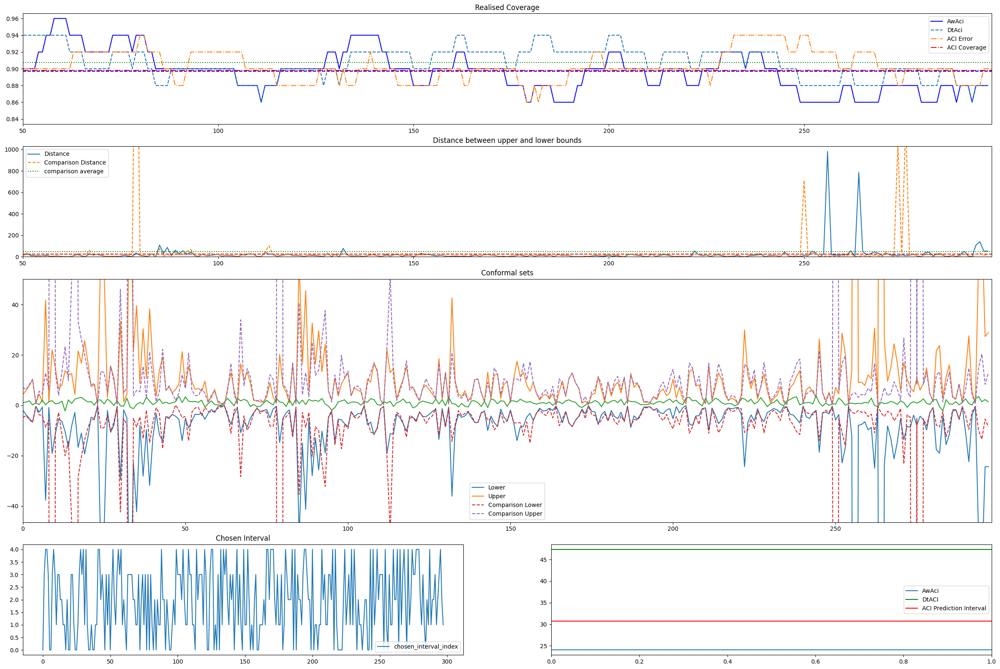

In [36]:
AwDT_plot(result, single_shift, True)

Outperforms.

In [37]:
random_shift = ACP_data.random_multi_shift(1, (2000,2001))[0]
random_result = t.AwAci(random_shift)

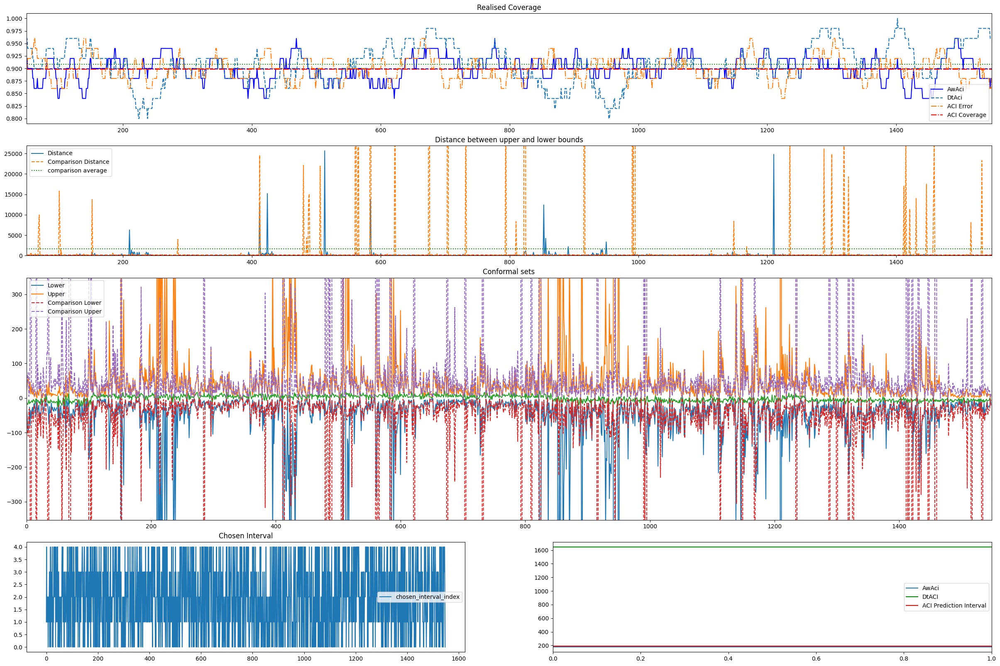

In [38]:
AwDT_plot(random_result, random_shift, True)

Equaly performs, outperforms DtACI

# Trying on Multiple Data.

coverage: 0.8990393595730487 interval:  258.78122203088583


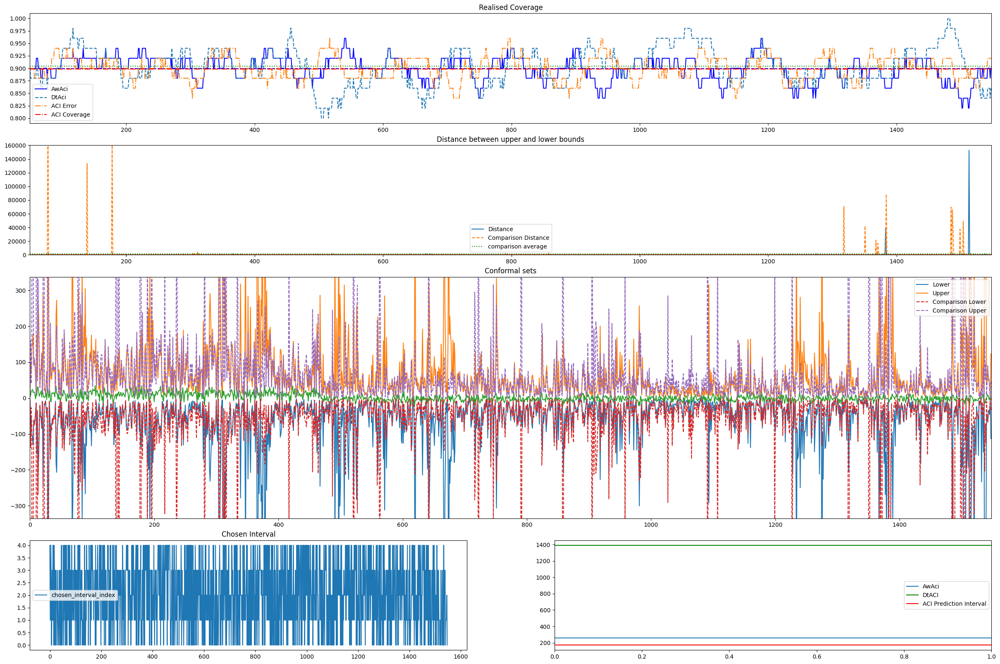

coverage: 0.9 interval:  184.92361113374565


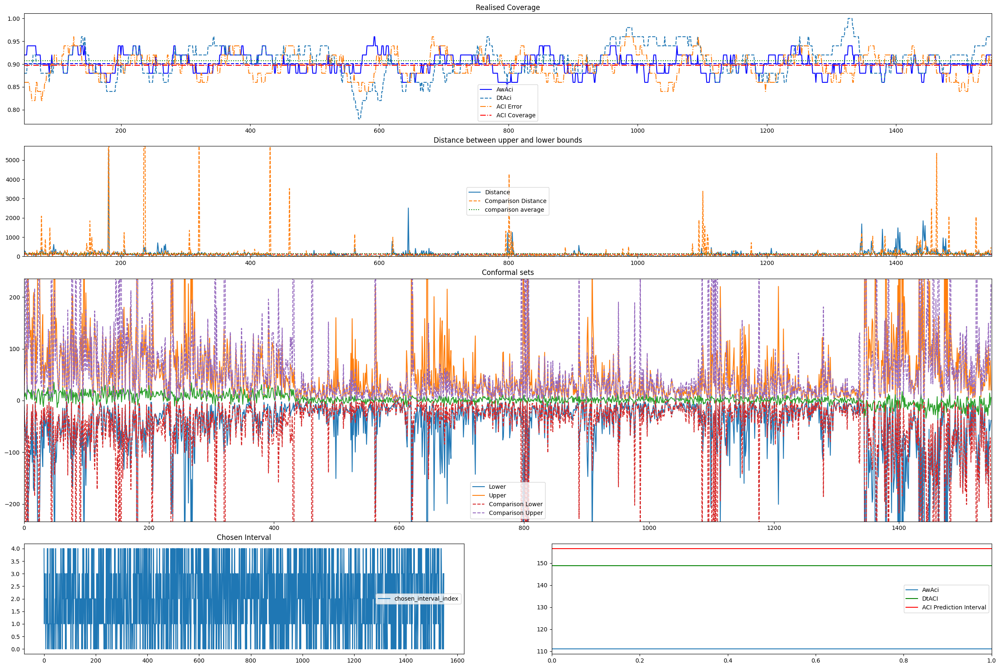

coverage: 0.8999110518123193 interval:  177.74615993939696


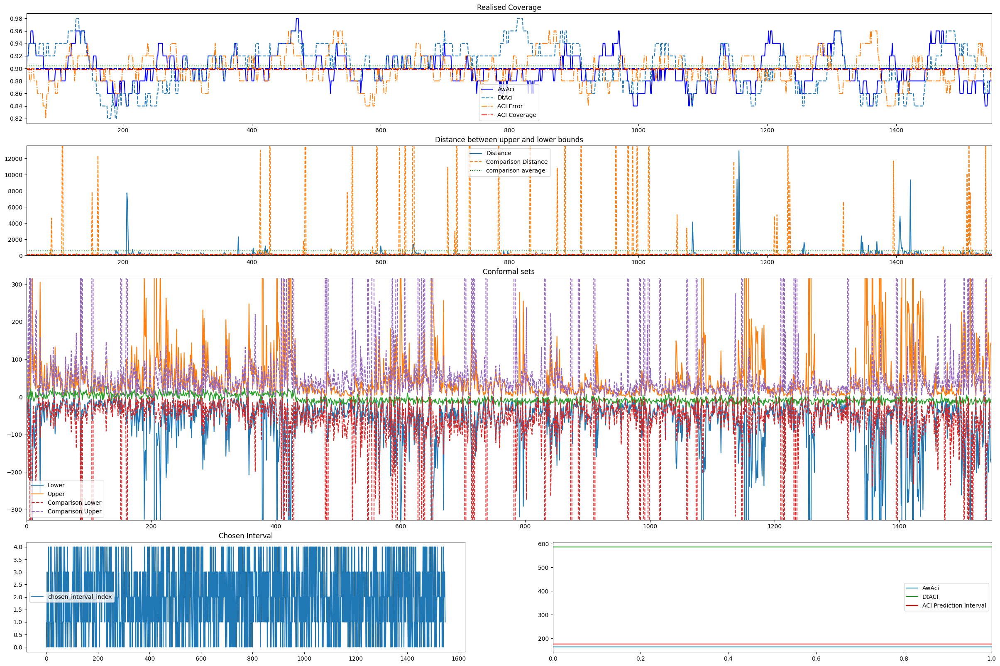

coverage: 0.8983832888592396 interval:  161.23311806074489


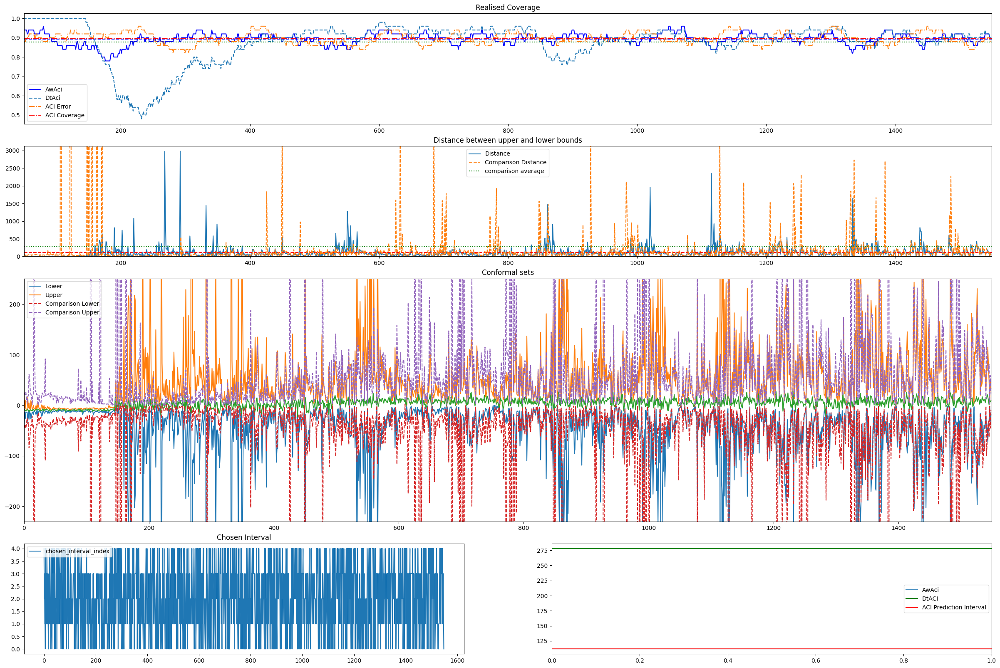

coverage: 0.8981729419613076 interval:  171.84874657815664


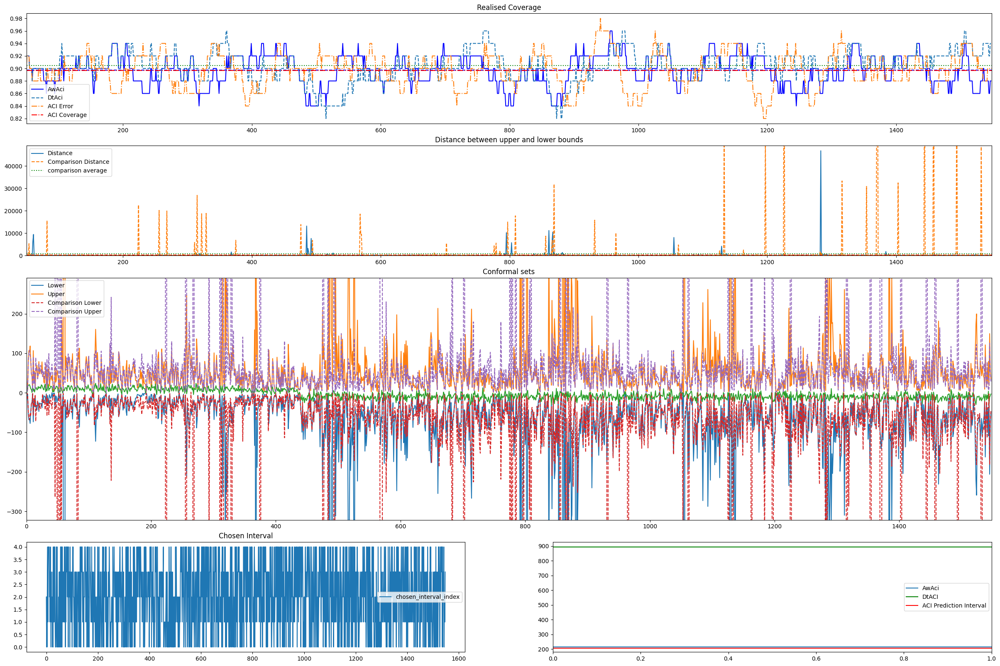

coverage: 0.8987841183010897 interval:  158.8462673442974


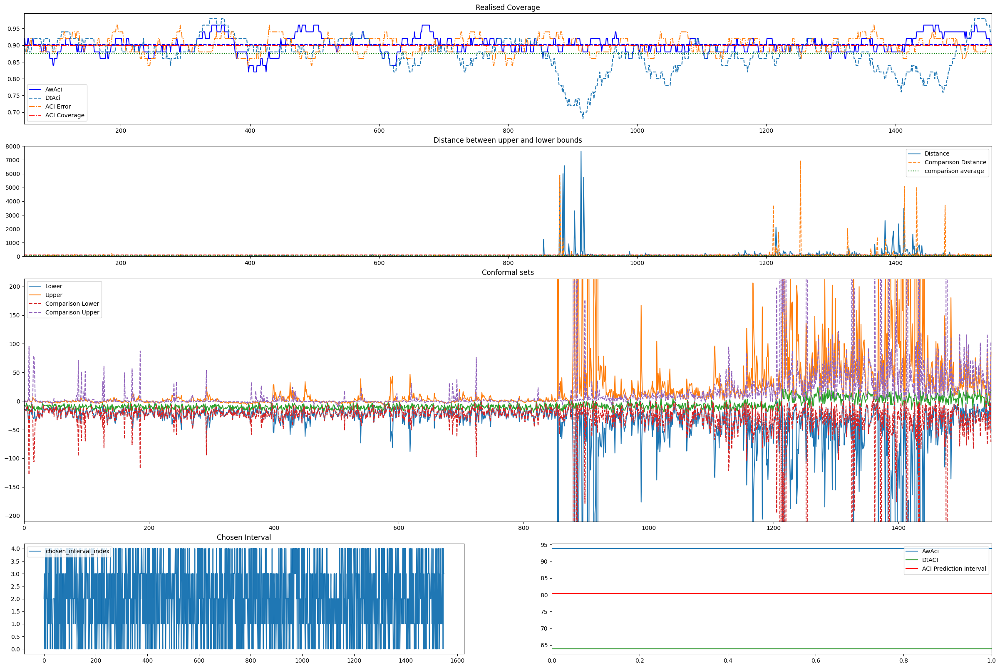

coverage: 0.8979895511293243 interval:  237.39381638372333


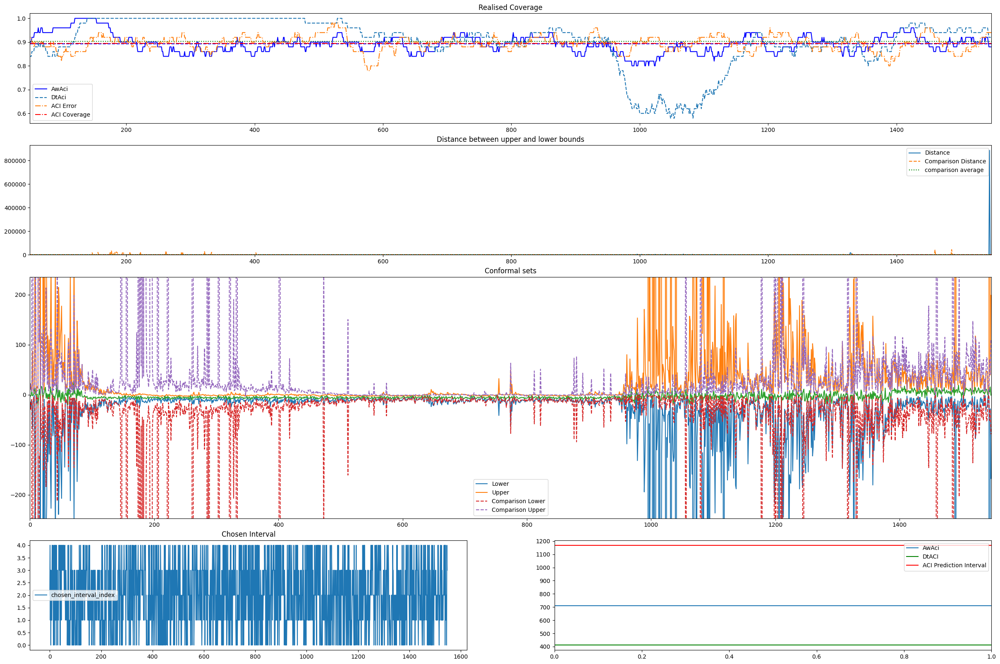

coverage: 0.8981574683122082 interval:  226.2494041298521


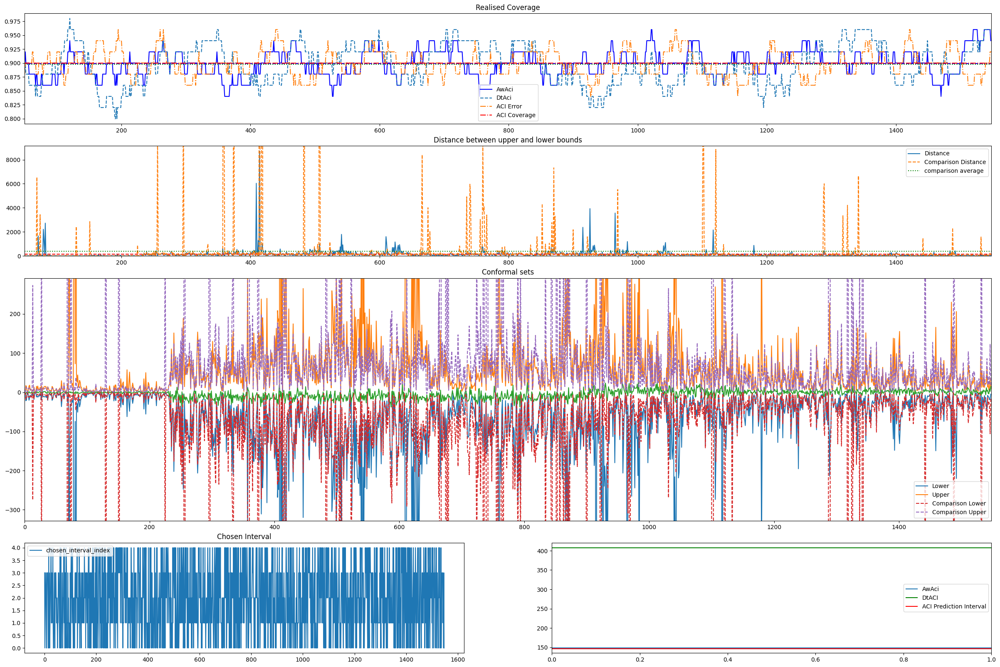

coverage: 0.8986112489808021 interval:  210.70679525024588


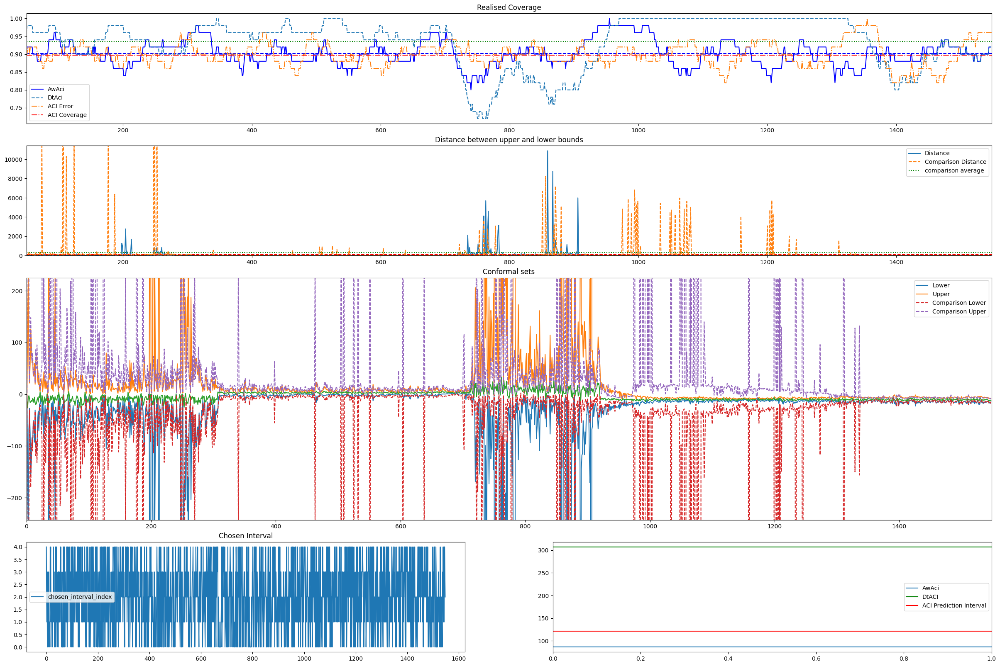

coverage: 0.8989167907493887 interval:  197.15074343233857


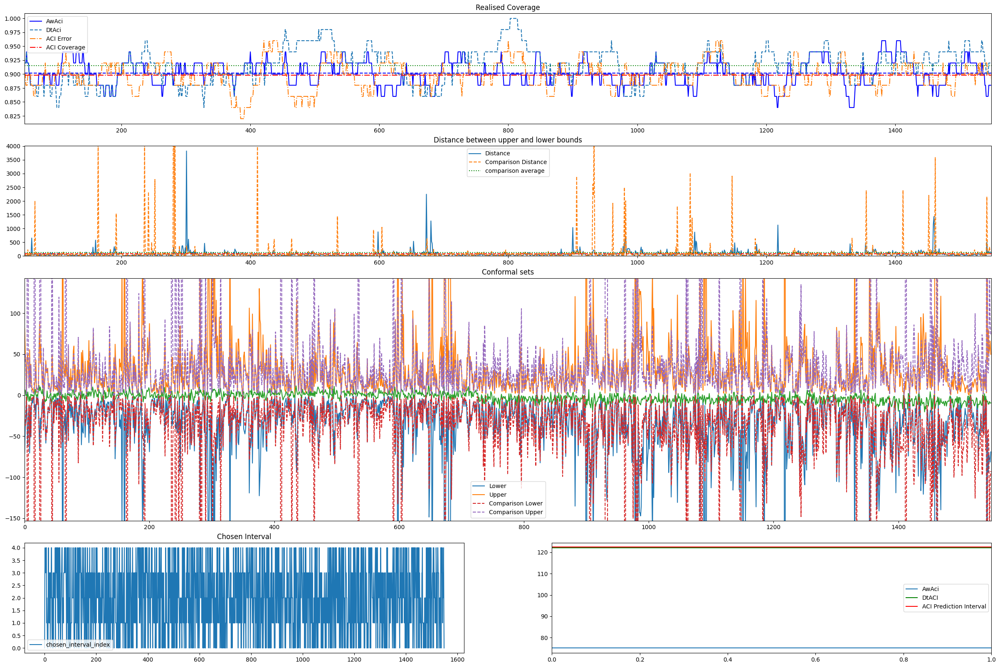

coverage: 0.898943749166111 interval:  183.48167742878704


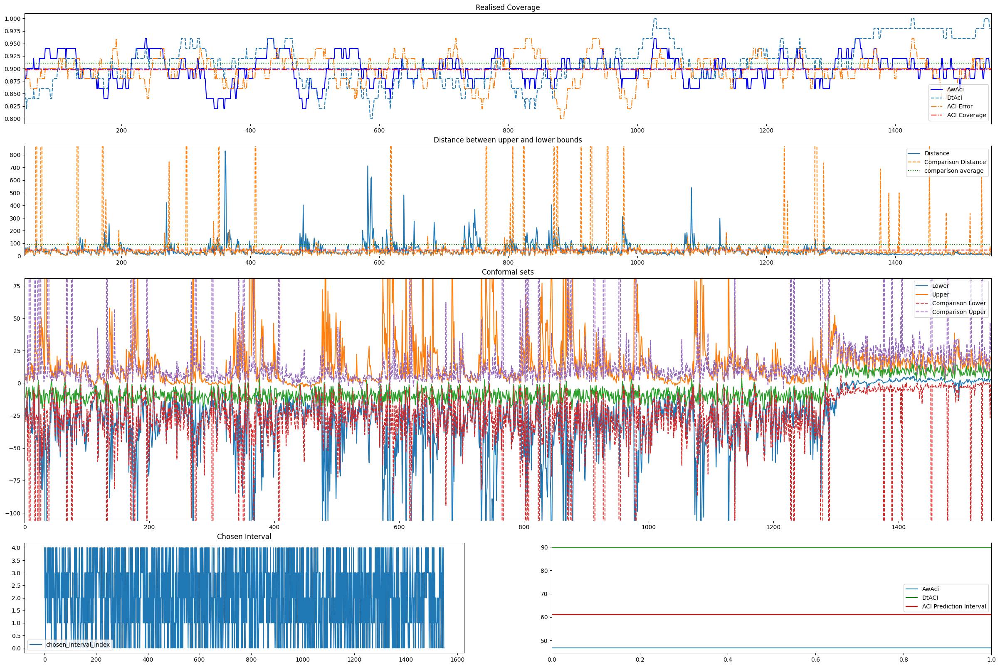

coverage: 0.8992107782966423 interval:  173.6495109418989


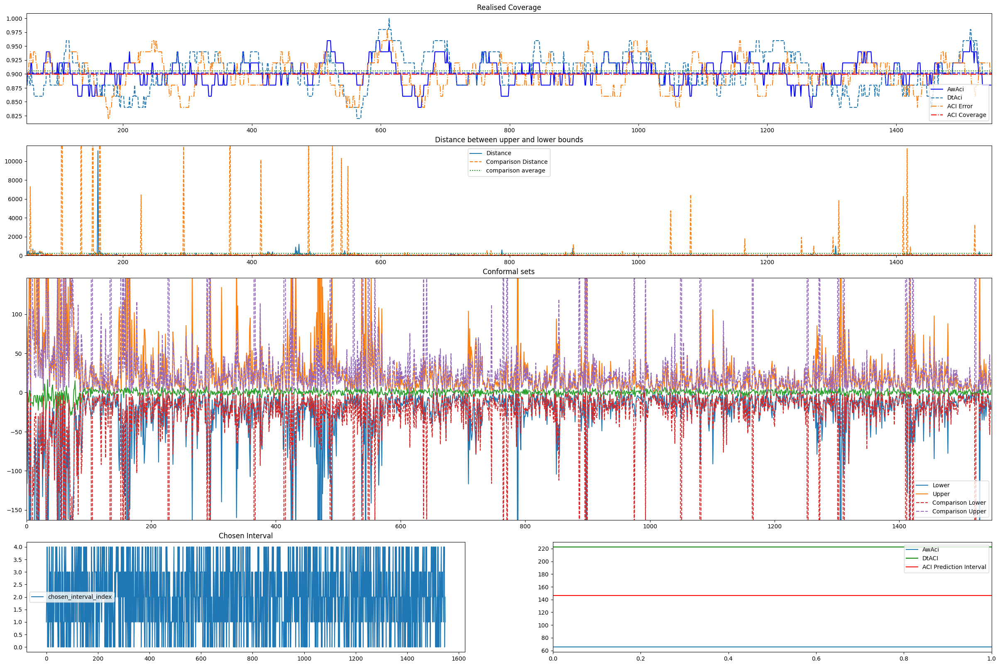

coverage: 0.8992684086827116 interval:  174.77424827401714


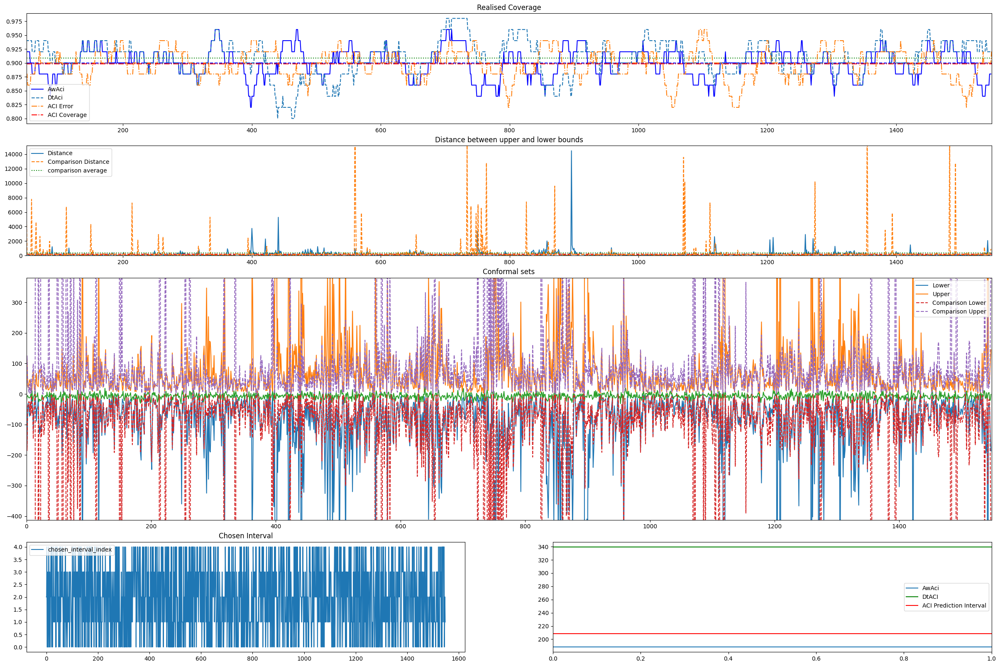

coverage: 0.8992435223482322 interval:  170.22512831447673


KeyboardInterrupt: 

In [31]:
all_random = ACP_data.random_multi_shift(20, (2000,2001))

cov = []
interval = []

for data in all_random:
    result = t.AwAci(data)
    cov.append(result['realised_interval_coverage'])
    interval.append(result['average_prediction_interval'])

    print('coverage:', np.mean(cov), 'interval: ', np.mean(interval))

    AwDT_plot(result, data, True)

    


Outperforms, DtACI sometimes peforms terribly and for that reason has less of an interval.

coverage: 0.902374916611074 interval:  170.14872726846917


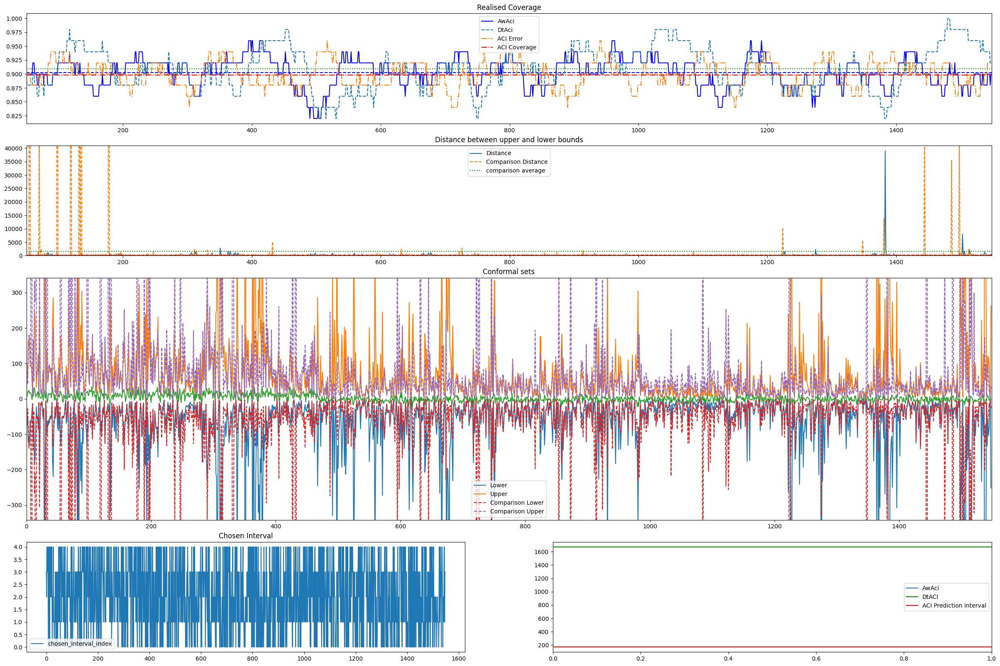

coverage: 0.9000400266844564 interval:  141.21385164027882


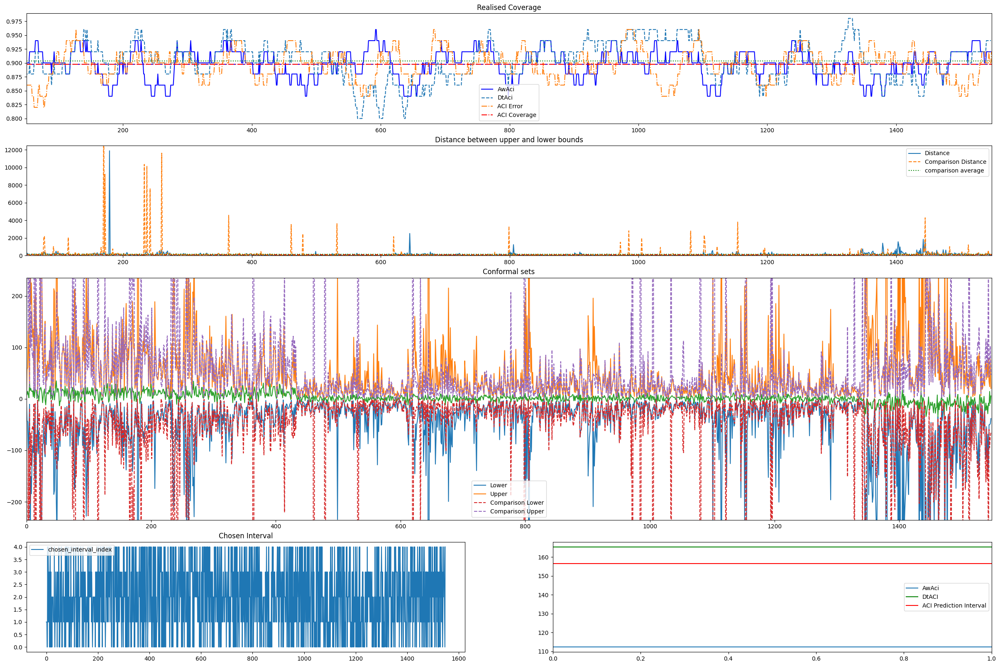

coverage: 0.8995686012897487 interval:  150.82846976603352


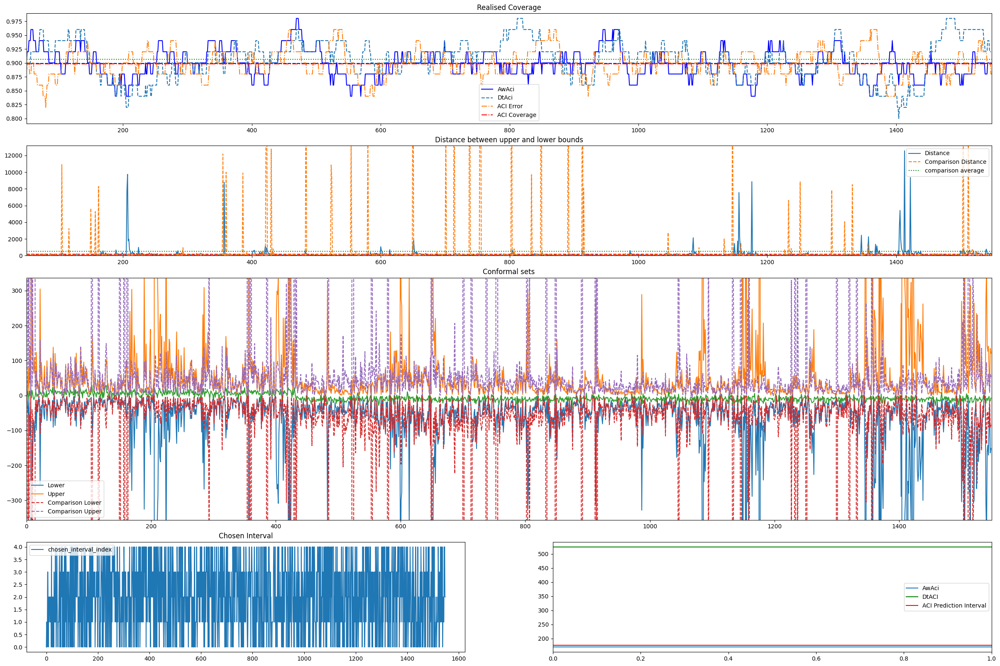

coverage: 0.8980464509673115 interval:  149.7719435728352


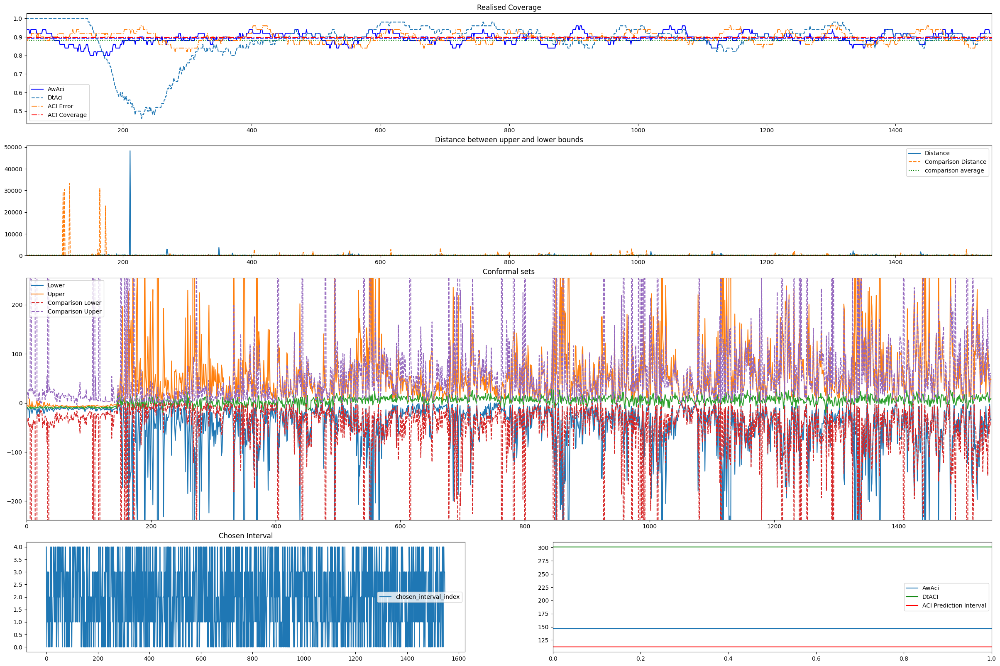

coverage: 0.8982637118078719 interval:  160.77426319866734


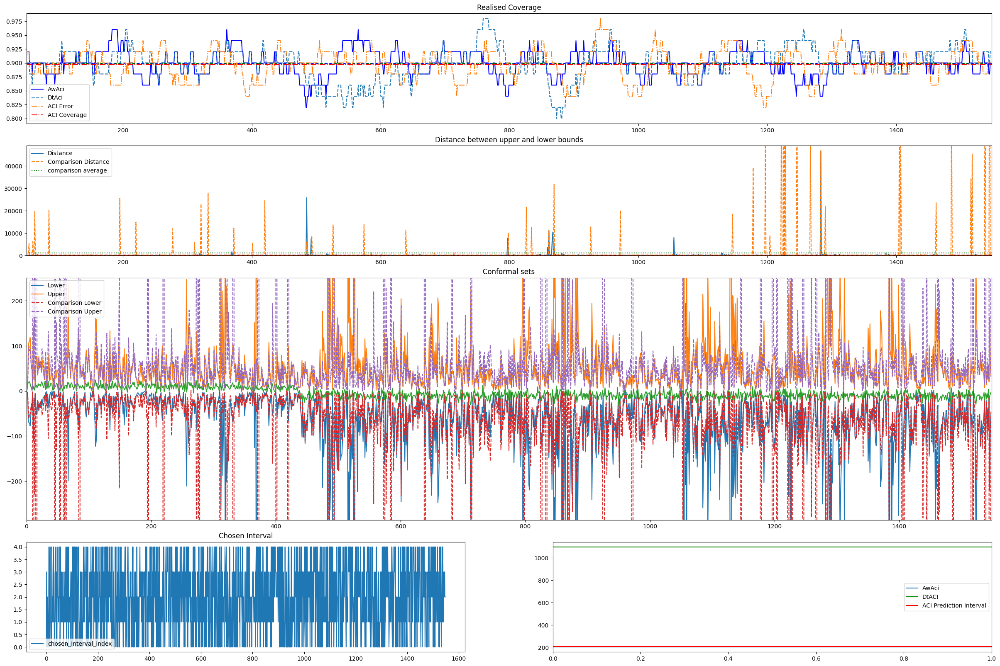

coverage: 0.8984153153954488 interval:  148.89283924798548
coverage: 0.898245244131008 interval:  226.423541420711
coverage: 0.8981310329108295 interval:  220.22939572012785
coverage: 0.8978064892644481 interval:  204.7329788735611
coverage: 0.8976831736713364 interval:  191.24828274217055
coverage: 0.8978368245496998 interval:  178.28855643533618
coverage: 0.8979181343117634 interval:  169.00135464950122
coverage: 0.8978740391029917 interval:  171.06465091811657
coverage: 0.8978982744051589 interval:  168.0582888888326
coverage: 0.8979966116670373 interval:  172.30960424598337
coverage: 0.8980325972870802 interval:  170.06604522676392
coverage: 0.8980730327407814 interval:  249.8860251857436
coverage: 0.8981104103970549 interval:  244.32056075085322
coverage: 0.8981628135716209 interval:  238.60457985094274
coverage: 0.8980386728930398 interval:  232.11808012305437


In [32]:
no_shift = ACP_data.no_shift((0,1), 2000, datapoints=20 )

cov = []
interval = []

for i, data in enumerate(all_random):
    result = t.AwAci(data)
    cov.append(result['realised_interval_coverage'])
    interval.append(result['average_prediction_interval'])

    print('coverage:', np.mean(cov), 'interval: ', np.mean(interval))

    if i<5:
        AwDT_plot(result, data, True)
